**Deep Lab**

A deep lab é considerada a rede do estado da arte na segmentação semântica.

Imagem -> desenho da máscara com o contorno do objeto.

Imagem -> Encoder (Atrrours conv) -> Decoder -> Saída

Atrours conv -> Utiliza taxas de dilatações diferentes na rede. Parâmetro rate = controla o campo de visão da convolução. Mas o tamanho do kernel se mantém o mesmo.

Spatial Pyramid Pooling (SPP): Utilizado para permitir que o modelo seja mais robusto a variações de escala na imagem de entrada. Recebe como entrada os mapas de características e retorna as camadas totalmente conectadas de uma rede neural. Utiliza várias versões da escala para o treinamento da rede, as informações.

Dephwise separable convolutions: usado para realizar convoluções realizando um menor número de cálculos possível.
- Dephwise convolutions: Convolução com um único kernel.
- Pointwise convolutions: aumentar o número de canais, utiliza um kernel 1x1 com profundidade igual à da imagem de entrada.

In [ ]:
import os
import tarfile
import tempfile

from six.moves import urllib
from io import BytesIO

from matplotlib import gridspec
from matplotlib import pyplot as plt
import numpy as np
import cv2
import IPython
from PIL import Image
from tqdm import tqdm
from tabulate import tabulate
from sklearn.metrics import confusion_matrix

import tensorflow as tf

import warnings
warnings.simplefilter('ignore', DeprecationWarning)

In [ ]:
class ModeloDeepLab(object):
  FROZEN_GRAPH_NAME = 'frozen_inference_graph'
  
  def __init__(self, tarball_path):
    self.graph = tf.Graph()
    graph_def = None

    tar_file = tarfile.open(tarball_path)
    for tar_info in tar_file.open(tarball_path):
      if self.FROZEN_GRAPH_NAME in os.path.basename(tar_info.name):
        file_handle = tar_file.extractfile(tar_info)
        graph_def = tf.compat.v1.GraphDef.FromString(file_handle.read())
        break
    
    tar_file.close()

    if graph_def is None:
      raise RuntimeError('Não foi possível encontrar o grafo de inferência da rede.')

    with self.graph.as_default():
      tf.import_graph_def(graph_def, name = '')
    
    self.sess = tf.compat.v1.Session(graph = self.graph)

  def run(self, image, INPUT_TENSOR_NAME = 'ImageTensor:0', OUTPUT_TENSOR_NAME = 'SemanticPredictions:0'):
    width, height = image.size
    target_size = (2019, 1025) # Tamanho das imagens do dataset Cityscapes
    resized_image = image.convert('RGB').resize(target_size, Image.ANTIALIAS)

    batch_seg_map = self.sess.run(
        OUTPUT_TENSOR_NAME,
        feed_dict={INPUT_TENSOR_NAME: [np.asarray(resized_image)]}
    )

    seg_map = batch_seg_map[0]
    if len(seg_map.shape) == 2:
      seg_map = np.expand_dims(seg_map, -1)
    
    seg_map = cv2.resize(seg_map, (width, height), interpolation = cv2.INTER_NEAREST)

    return seg_map

In [ ]:
def create_label_colormap():
    """Creates a label colormap used in Cityscapes segmentation benchmark.

    Returns:
        A Colormap for visualizing segmentation results.
    """
    colormap = np.array([
        [128,  64, 128],
        [244,  35, 232],
        [ 70,  70,  70],
        [102, 102, 156],
        [190, 153, 153],
        [153, 153, 153],
        [250, 170,  30],
        [220, 220,   0],
        [107, 142,  35],
        [152, 251, 152],
        [ 70, 130, 180],
        [220,  20,  60],
        [255,   0,   0],
        [  0,   0, 142],
        [  0,   0,  70],
        [  0,  60, 100],
        [  0,  80, 100],
        [  0,   0, 230],
        [119,  11,  32],
        [  0,   0,   0]], dtype=np.uint8)
    return colormap


def label_to_color_image(label):
    """Adds color defined by the dataset colormap to the label.

    Args:
        label: A 2D array with integer type, storing the segmentation label.

    Returns:
        result: A 2D array with floating type. The element of the array
            is the color indexed by the corresponding element in the input label
            to the PASCAL color map.

    Raises:
        ValueError: If label is not of rank 2 or its value is larger than color
            map maximum entry.
    """
    if label.ndim != 2:
        raise ValueError('Expect 2-D input label')

    colormap = create_label_colormap()

    if np.max(label) >= len(colormap):
        raise ValueError('label value too large.')

    return colormap[label]


def vis_segmentation(image, seg_map):
    seg_image = label_to_color_image(seg_map).astype(np.uint8)
    """Visualizes input image, segmentation map and overlay view."""
    plt.figure(figsize=(20, 4))
    grid_spec = gridspec.GridSpec(1, 4, width_ratios=[6, 6, 6, 1])

    plt.subplot(grid_spec[0])
    plt.imshow(image)
    plt.axis('off')
    plt.title('input image')

    plt.subplot(grid_spec[1])
    seg_image = label_to_color_image(seg_map).astype(np.uint8)
    plt.imshow(seg_image)
    plt.axis('off')
    plt.title('segmentation map')

    plt.subplot(grid_spec[2])
    plt.imshow(image)
    plt.imshow(seg_image, alpha=0.7)
    plt.axis('off')
    plt.title('segmentation overlay')

    unique_labels = np.unique(seg_map)
    ax = plt.subplot(grid_spec[3])
    plt.imshow(FULL_COLOR_MAP[unique_labels].astype(np.uint8), interpolation='nearest')
    ax.yaxis.tick_right()
    plt.yticks(range(len(unique_labels)), LABEL_NAMES[unique_labels])
    plt.xticks([], [])
    ax.tick_params(width=0.0)
    plt.grid('off')
    plt.show()
    return cv2.addWeighted(np.uint8(image), 0.3, np.uint8(seg_image), 0.7, 0)

LABEL_NAMES = np.asarray([
    'road', 'sidewalk', 'building', 'wall', 'fence', 'pole', 'traffic light',
    'traffic sign', 'vegetation', 'terrain', 'sky', 'person', 'rider', 'car', 'truck',
    'bus', 'train', 'motorcycle', 'bicycle', 'void'])

FULL_LABEL_MAP = np.arange(len(LABEL_NAMES)).reshape(len(LABEL_NAMES), 1)
FULL_COLOR_MAP = label_to_color_image(FULL_LABEL_MAP)

**Carregamento da rede neural**

- MobileNetV2: Permite realizar a inferência de forma rápida. Projetada para ser executada em hardware menos potentes;
- Xception65: Mais custoso computacionalmente, mas oferece resultados precisos e consequentemente uma segmentação mais próxima da real.

In [ ]:
MODEL_NAME = 'mobilenetv2_coco_cityscapes_trainfine'
#MODEL_NAME = 'xception65_cityscapes_trainfile'

In [ ]:
DOWNLOAD_URL_PREFIX = 'http://download.tensorflow.org/models/'
MODEL_URLS = {
    'mobilenetv2_coco_cityscapes_trainfine':
        'deeplabv3_mnv2_cityscapes_train_2018_02_05.tar.gz',
    'xception65_cityscapes_trainfine':
        'deeplabv3_cityscapes_train_2018_02_06.tar.gz',
}

In [ ]:
TARBALL_NAME = 'deeplab_model.tar.gz'
model_dir = tempfile.mkdtemp()
tf.io.gfile.makedirs(model_dir)

In [ ]:
download_path = os.path.join(model_dir, TARBALL_NAME)

In [ ]:
download_path

'/tmp/tmp96254k27/deeplab_model.tar.gz'

In [ ]:
# Download da rede
urllib.request.urlretrieve(DOWNLOAD_URL_PREFIX + MODEL_URLS[MODEL_NAME], download_path)

('/tmp/tmp96254k27/deeplab_model.tar.gz',
 <http.client.HTTPMessage at 0x7f4a3a49ba50>)

In [ ]:
model = ModeloDeepLab(download_path)

**Segmentação de imagens**

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!cp /content/gdrive/MyDrive/Mestrado/Cursos\ -\ Udemy/Segmentação\ de\ imagens/Segmentação\ Imagens\ Python\ AZ/fotos/driveseg_amostra.jpg /content/driveseg_amostra.jpg

In [ ]:
img_teste = '/content/driveseg_amostra.jpg'

In [ ]:
def executar_segmentacao(caminho):
  img_or = Image.open(caminho) # A rede recebe as imagens no formato da biblioteca PIL
  seg_map = model.run(img_or)
  img_processada = vis_segmentation(img_or, seg_map)
  return img_processada

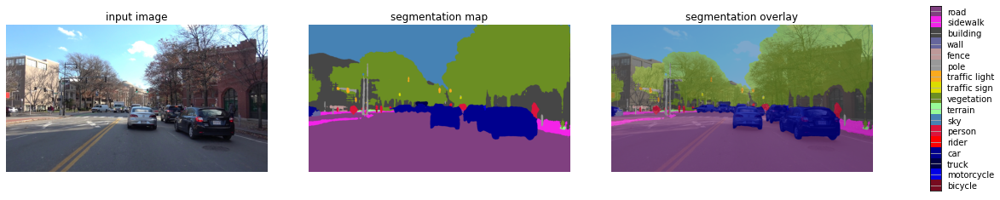

In [ ]:
img_processada = executar_segmentacao(img_teste)

**Segmentação em video**

In [ ]:
def vis_segmentation_stream(image, seg_map, index):
    """Visualizes segmentation overlay view and stream it with IPython display."""
    plt.figure(figsize=(12, 7))

    seg_image = label_to_color_image(seg_map).astype(np.uint8)
    plt.imshow(image)
    plt.imshow(seg_image, alpha=0.7)
    plt.axis('off')
    plt.title('segmentation overlay | frame #%d'%index)
    plt.grid('off')
    plt.tight_layout()

    # Show visualization in a streaming fashion.
    f = BytesIO()
    plt.savefig(f, format='jpeg')
    IPython.display.display(IPython.display.Image(data=f.getvalue()))
    f.close()
    plt.close()

    return cv2.addWeighted(np.uint8(image), 0.3, np.uint8(seg_image), 0.7, 0)


def run_visualization_video(frame, index):
    """Inferences DeepLab model on a video file and stream the visualization."""
    original_im = Image.fromarray(frame[..., ::-1])
    seg_map = model.run(original_im)
    frame = vis_segmentation_stream(original_im, seg_map, index)
    return cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

In [45]:
def configs_video(altura, largura, nome = 'resultado.avi'):
  fourcc = cv2.VideoWriter_fourcc(*'XVID')
  fps = 24
  return cv2.VideoWriter(nome, fourcc, fps, (largura, altura))

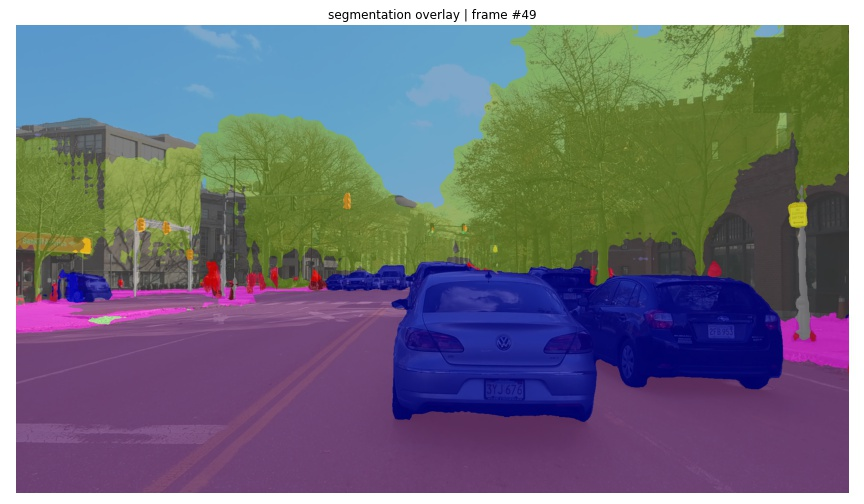

In [46]:
SAMPLE_VIDEO = 'mit_driveseg_sample.mp4'
if not os.path.isfile(SAMPLE_VIDEO): 
    print('downloading the sample video...')
    SAMPLE_VIDEO = urllib.request.urlretrieve('https://github.com/lexfridman/mit-deep-learning/raw/master/tutorial_driving_scene_segmentation/mit_driveseg_sample.mp4')[0]
print('running deeplab on the sample video...')

cap = cv2.VideoCapture(SAMPLE_VIDEO)
# num_frames = 598  # uncomment to use the full sample video
num_frames = 50
frame_inicio = 0
frame_atual = 0

conectado, video = cap.read()
largura, altura = video.shape[1], video.shape[0]
saida = configs_video(altura, largura) 

try:
    for i in range(num_frames):
        _, frame = cap.read()
        if not _: break

        if i < frame_inicio:
          continue
        
        frame = run_visualization_video(frame, i)
        IPython.display.clear_output(wait=True)

        frame_atual += 1
        saida.write(frame)

except KeyboardInterrupt:
    plt.close()
    print("Stream stopped.")

In [47]:
!!ffmpeg -y -loglevel panic -i resulado.avi resultado.mp4

[]

In [ ]:
def exibir_video(nome, largura = 720, altura = 480):
  import io
  import base64
  from IPython.display import HTML
  video = base64.b64encode(io.open(nome, 'rb').read())

  return HTML(data = '''<video width = "{0}" height = "{1}" alt = "Vídeo teste" controls>
                            <source src = "data:video/mp4;base64,{2}" type = "video/mp4"/>
                        </video>'''.format(largura, altura, video.decode('ascii')))

In [ ]:
exibir_video('resultado.mp4')

**Avalição das imagens do vídeo**

In [50]:
class DriveSeg(object):
    """Class to load MIT DriveSeg Dataset."""

    def __init__(self, tarball_path):
        self.tar_file = tarfile.open(tarball_path)
        self.tar_info = self.tar_file.getmembers()
    
    def fetch(self, index):
        """Get ground truth by index.

        Args:
            index: The frame number.

        Returns:
            gt: Ground truth segmentation map.
        """
        tar_info = self.tar_info[index + 1]  # exclude index 0 which is the parent directory
        file_handle = self.tar_file.extractfile(tar_info)
        gt = np.fromstring(file_handle.read(), np.uint8)
        gt = cv2.imdecode(gt, cv2.IMREAD_COLOR)
        gt = gt[:, :, 0]  # select a single channel from the 3-channel image
        gt[gt==255] = 19  # void class, does not count for accuracy
        return gt


SAMPLE_GT = 'mit_driveseg_sample_gt.tar.gz'
if not os.path.isfile(SAMPLE_GT): 
    print('downloading the sample ground truth...')
    SAMPLE_GT = urllib.request.urlretrieve('https://github.com/lexfridman/mit-deep-learning/raw/master/tutorial_driving_scene_segmentation/mit_driveseg_sample_gt.tar.gz')[0]

dataset = DriveSeg(SAMPLE_GT)
print('visualizing ground truth annotation on the sample image...')

downloading the sample ground truth...
visualizing ground truth annotation on the sample image...


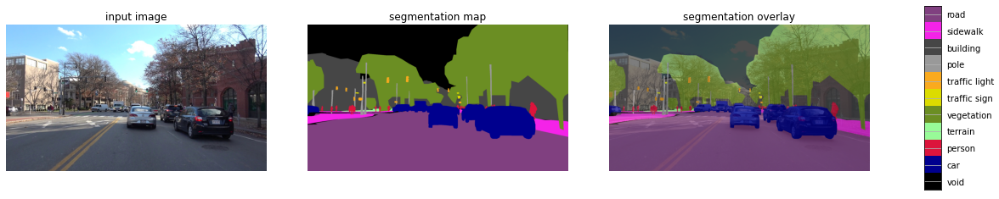

array([[[ 41,  60,  76],
        [ 41,  60,  76],
        [ 41,  60,  76],
        ...,
        [147, 176, 101],
        [147, 176, 101],
        [146, 176, 101]],

       [[ 41,  60,  76],
        [ 41,  60,  76],
        [ 41,  60,  76],
        ...,
        [147, 176, 101],
        [ 72,  76,  76],
        [ 71,  76,  76]],

       [[ 41,  60,  76],
        [ 41,  60,  76],
        [ 41,  60,  76],
        ...,
        [ 72,  76,  76],
        [ 72,  76,  76],
        [ 72,  76,  76]],

       ...,

       [[109,  66, 116],
        [109,  66, 116],
        [109,  66, 116],
        ...,
        [107,  63, 113],
        [107,  63, 112],
        [107,  63, 112]],

       [[108,  65, 116],
        [109,  66, 116],
        [108,  65, 116],
        ...,
        [107,  63, 112],
        [107,  63, 112],
        [107,  63, 112]],

       [[109,  66, 116],
        [109,  66, 116],
        [109,  66, 116],
        ...,
        [107,  63, 112],
        [107,  63, 112],
        [107,  63, 112]]

In [51]:
original_im = Image.open(img_teste)
gt = dataset.fetch(126)  # sample image is frame 126
vis_segmentation(original_im, gt)

In [56]:
def avaliar_imagem(seg_map, ground_truth):
  seg_map[np.logical_or(seg_map == 14, seg_map == 15)] = 13
  seg_map[np.logical_or(seg_map == 3, seg_map == 4)] = 2
  seg_map[seg_map == 12] = 11

  # Pixel accuracy
  acc = np.sum(seg_map[ground_truth != 19] == ground_truth[ground_truth != 19]) / np.sum(ground_truth != 19) # 19 = void
  cm = confusion_matrix(ground_truth[ground_truth != 19], seg_map[ground_truth != 19], labels = np.array([0,1,2,5,6,7,8,9,11,13]))

  interseccao =  np.diag(cm)
  uniao = np.sum(cm, 0) + np.sum(cm, 1) - np.diag(cm)

  return acc, interseccao, uniao  

In [58]:
img_or = Image.open(img_teste)
seg_map = model.run(img_or)
gt = dataset.fetch(126)

acc, interseccao, uniao = avaliar_imagem(seg_map, gt)

class_iou = np.round(interseccao / uniao, 5)
print('Acurácia dos pixels:',acc)
print('Média do IoU:', np.mean(class_iou))
print('IoU das classes:')
print(tabulate([class_iou], headers = LABEL_NAMES[[0,1,2,5,6,7,8,9,11,13]]))

Acurácia dos pixels: 0.9021771351593251
Média do IoU: 0.545528
IoU das classes:
   road    sidewalk    building     pole    traffic light    traffic sign    vegetation    terrain    person      car
-------  ----------  ----------  -------  ---------------  --------------  ------------  ---------  --------  -------
0.96847     0.54177     0.55832  0.29149          0.34221         0.17846       0.81754    0.24206   0.56615  0.94881


In [61]:
SAMPLE_VIDEO = 'mit_driveseg_sample.mp4'
if not os.path.isfile(SAMPLE_VIDEO): 
    print('downloading the sample video...')
    SAMPLE_VIDEO = urllib.request.urlretrieve('https://github.com/lexfridman/mit-deep-learning/raw/master/tutorial_driving_scene_segmentation/mit_driveseg_sample.mp4')[0]
print('running deeplab on the sample video...')

video = cv2.VideoCapture(SAMPLE_VIDEO)
num_frames = 598

acc = []
intereseccao = []
uniao = []

for i in tqdm(range(num_frames)):
  _, frame = video.read()
  img_or = Image.fromarray(frame[..., ::-1])
  seg_map = model.run(img_or)
  gt = dataset.fetch(i)
  _acc, _interseccao, _uniao = avaliar_imagem(seg_map, gt)
  intereseccao.append(_interseccao)
  uniao.append(_uniao)
  acc.append(_acc)

downloading the sample video...
running deeplab on the sample video...


100%|██████████| 598/598 [15:11<00:00,  1.52s/it]


In [62]:
class_iou = np.round(np.sum(interseccao, 0) / np.sum(uniao, 0), 5)
print('Acurácia dos pixels:',np.mean(acc))
print('Média do IoU:', np.mean(class_iou))
print('IoU das classes:')
print(tabulate([class_iou], headers = LABEL_NAMES[[0,1,2,5,6,7,8,9,11,13]]))

Acurácia dos pixels: 0.8824273052528012
Média do IoU: 0.11982399999999997
IoU das classes:
   road    sidewalk    building     pole    traffic light    traffic sign    vegetation    terrain    person      car
-------  ----------  ----------  -------  ---------------  --------------  ------------  ---------  --------  -------
0.00397     0.04156      0.0061  0.08818          0.46975         0.25482       0.00452    0.19818   0.11877  0.01239
